In [ ]:

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True)
from __future__ import print_function
import torch.backends.cudnn as cudnn
import torchvision.utils as vutils

Random Seed:  999


In [ ]:
cudnn.benchmark = True

In [ ]:
dataset = dset.CIFAR10(root="./data", download=True,
                           transform=transforms.Compose([
                               transforms.Resize(32),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
nc=3

dataloader = torch.utils.data.DataLoader(dataset, batch_size=128,
                                         shuffle=True, num_workers=2)


100%|██████████| 170M/170M [00:01<00:00, 92.2MB/s]


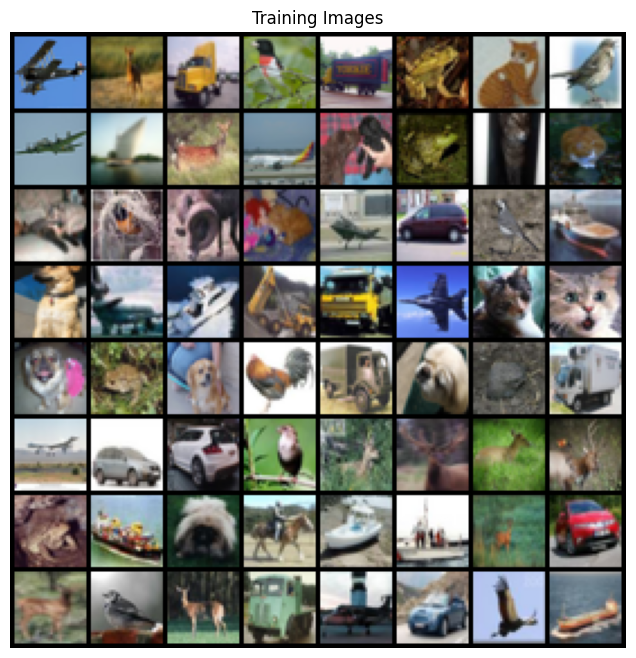

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [ ]:
# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 30

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 0


In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d( nz, ngf * 4, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
netG = Generator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
netD = Discriminator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)


print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (9): Sigmoid()
  )
)


In [ ]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 0.9
fake_label = 0.1


optimizerG = torch.optim.RMSprop(
    netG.parameters(),
    lr=3e-4,
    alpha=0.99,
    eps=1e-8
)

optimizerD = torch.optim.RMSprop(
    netD.parameters(),
    lr=3e-4,
    alpha=0.99,
    eps=1e-8
)

#optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
#optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
# Training Loop


img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/30][0/391]	Loss_D: 1.5652	Loss_G: 9.8148	D(x): 0.3975	D(G(z)): 0.3978 / 0.0000
[0/30][50/391]	Loss_D: 1.5121	Loss_G: 1.1131	D(x): 0.5697	D(G(z)): 0.4757 / 0.4139
[0/30][100/391]	Loss_D: 1.4397	Loss_G: 0.6703	D(x): 0.3759	D(G(z)): 0.3247 / 0.5380
[0/30][150/391]	Loss_D: 1.5200	Loss_G: 0.7542	D(x): 0.3912	D(G(z)): 0.3739 / 0.4943
[0/30][200/391]	Loss_D: 1.3490	Loss_G: 1.4056	D(x): 0.6273	D(G(z)): 0.5639 / 0.2337
[0/30][250/391]	Loss_D: 1.3939	Loss_G: 1.7328	D(x): 0.6910	D(G(z)): 0.6107 / 0.1683
[0/30][300/391]	Loss_D: 1.1839	Loss_G: 0.7561	D(x): 0.4825	D(G(z)): 0.2792 / 0.4710
[0/30][350/391]	Loss_D: 1.1185	Loss_G: 1.2372	D(x): 0.6249	D(G(z)): 0.3995 / 0.2892
[1/30][0/391]	Loss_D: 1.4851	Loss_G: 1.8408	D(x): 0.6911	D(G(z)): 0.6454 / 0.1435
[1/30][50/391]	Loss_D: 1.3614	Loss_G: 1.6497	D(x): 0.7300	D(G(z)): 0.6170 / 0.1879
[1/30][100/391]	Loss_D: 1.2613	Loss_G: 1.3413	D(x): 0.6880	D(G(z)): 0.5418 / 0.2522
[1/30][150/391]	Loss_D: 1.1183	Loss_G: 0.9424	D(x): 0.55

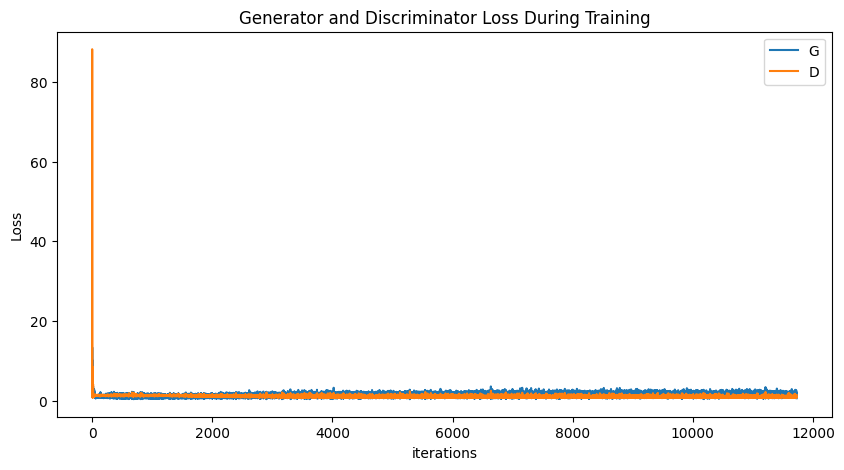

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

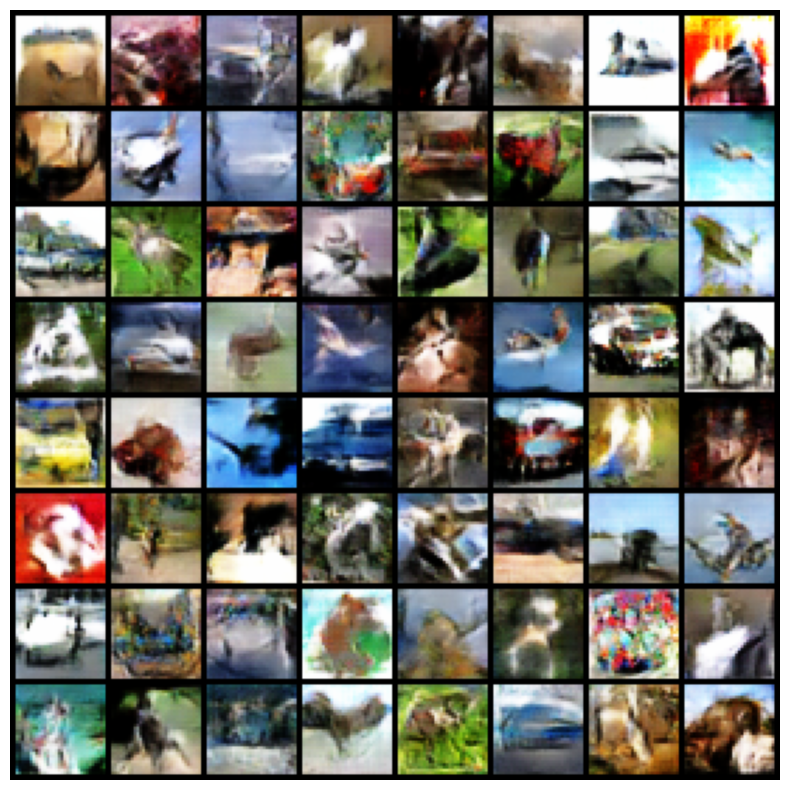

In [ ]:


fig = plt.figure(figsize=(10,10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

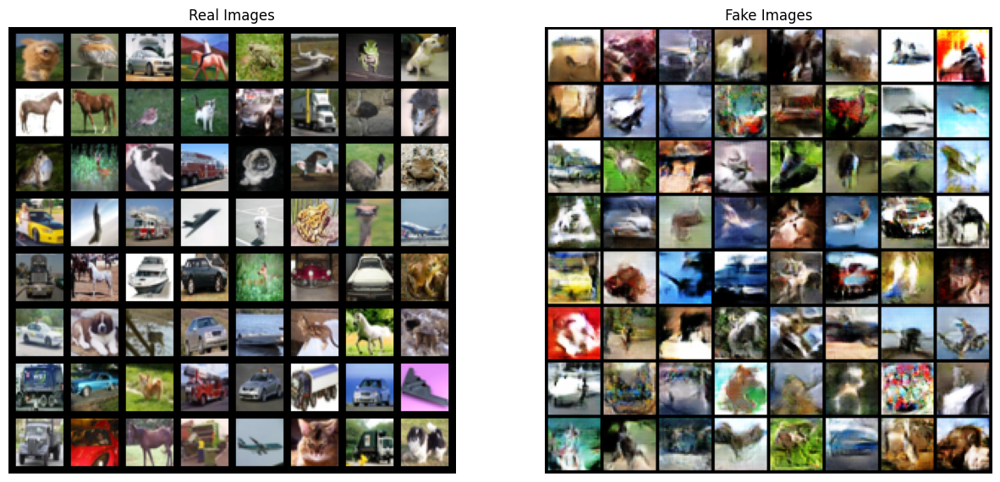

In [ ]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))


plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [ ]:
import torch
import torch.nn.functional as F
from math import exp
from torchvision.models import inception_v3
import numpy as np

def inception_score(
    generator,
    nz_latent: int,
    n_samples: int = 5000,
    batch_size: int = 100,
    splits: int = 10,
    device: str = 'cuda'
):
    try:
        inception = inception_v3(pretrained=True, transform_input=False, aux_logits=True).to(device)
    except Exception as e:
         print(f"Error loading InceptionV3: {e}")
         print("Please ensure torchvision is installed and try again: !pip install torchvision")
         return (np.nan, np.nan)

    inception.eval()
    for p in inception.parameters():
        p.requires_grad_(False)
    N = n_samples
    preds = torch.zeros(N, 1000, device='cpu')

    n_batches = n_samples // batch_size
    assert n_batches * batch_size == n_samples, "n_samples must be divisible by batch_size"

    idx = 0
    with torch.no_grad():
        for _ in range(n_batches):
            z = torch.randn(batch_size, nz_latent, device=device)
            z = z.view(batch_size, nz_latent, 1, 1)
            fake_imgs = generator(z)
            current_h, current_w = fake_imgs.shape[2:]
            if current_h != 299 or current_w != 299:
                 fake_imgs = F.interpolate(fake_imgs, size=(299, 299),
                                          mode='bilinear', align_corners=False)
            fake_imgs = (fake_imgs + 1.0) / 2.0
            mean = torch.tensor([0.485, 0.456, 0.406],
                                device=device).view(1, 3, 1, 1)
            std  = torch.tensor([0.229, 0.224, 0.225],
                                device=device).view(1, 3, 1, 1)
            fake_imgs = (fake_imgs - mean) / std
            logits = inception(fake_imgs)
            if isinstance(logits, tuple):
                logits = logits[0]

            softmax_out = F.softmax(logits, dim=1)
            preds[idx : idx + batch_size, :] = softmax_out.cpu()
            idx += batch_size
    preds_np = preds.numpy()
    scores = []
    split_size = N // splits

    for k in range(splits):
        start = k * split_size
        end   = (k + 1) * split_size
        part  = preds_np[start:end, :]
        py = np.mean(part, axis=0, keepdims=True)
        kl_divs = part * (np.log(part + 1e-16) - np.log(py + 1e-16))
        sum_kl = np.sum(kl_divs, axis=1)
        avg_kl = np.mean(sum_kl)
        is_k   = exp(avg_kl)
        scores.append(is_k)

    is_mean = float(np.mean(scores))
    is_std  = float(np.std(scores))
    return is_mean, is_std


nz_dcgan = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

is_mean_gan, is_std_gan = inception_score(
    generator   = netG,
    nz_latent   = nz_dcgan,
    n_samples   = 5000,
    batch_size  = 100,
    splits      = 10,
    device      = device
)
print(f"Inception Score (DCGAN): {is_mean_gan:.4f} ± {is_std_gan:.4f}")

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Inception Score (DCGAN): 4.5548 ± 0.0954


In [ ]:
nz = 256
ngf = 128
ndf = 128

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
class Encoder(nn.Module):
    def __init__(self, nc, ndf, nz):
        super(Encoder, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, 2 * nz, 4, 1, 0, bias=False)
        )

    def forward(self, x):
        x = self.main(x)
        mu, logvar = x.chunk(2, dim=1)
        mu = mu.squeeze()
        logvar = logvar.squeeze()
        return mu, logvar

class Decoder(nn.Module):
    def __init__(self, nc, ngf, nz):
        super(Decoder, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d( nz, ngf * 4, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

class VAE(nn.Module):
    def __init__(self, nc, ndf, ngf, nz):
        super(VAE, self).__init__()
        self.encoder = Encoder(nc, ndf, nz)
        self.decoder = Decoder(nc, ngf, nz)
        self.nz = nz

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        mu, logvar = self.encoder(x)
        z = self.reparameterize(mu, logvar)
        z = z.unsqueeze(-1).unsqueeze(-1)
        reconstruction = self.decoder(z)
        return reconstruction, mu, logvar


netVAE = VAE(nc, ndf, ngf, nz).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netVAE = nn.DataParallel(netVAE, list(range(ngpu)))

print(netVAE)

def vae_loss_function(recon_x, x, mu, logvar):
    MSE = nn.functional.mse_loss(recon_x, x, reduction='sum')

    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    return MSE + KLD


optimizerVAE = torch.optim.RMSprop(
    netVAE.parameters(),
    lr=3e-4,
    alpha=0.99,
    eps=1e-8
)


#optimizerVAE = optim.Adam(netVAE.parameters(), lr=lr, betas=(0.9, 0.999)) # Commented out duplicate optimizer setup

VAE(
  (encoder): Encoder(
    (main): Sequential(
      (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
      (3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace=True)
      (6): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): LeakyReLU(negative_slope=0.2, inplace=True)
      (9): Conv2d(512, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    )
  )
  (decoder): Decoder(
    (main): Sequential(
      (0): ConvTranspose2d(256, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d


Starting VAE Training Loop...
[0/30][0/391]	VAE Loss: 2340.0823
[0/30][50/391]	VAE Loss: 866.7195
[0/30][100/391]	VAE Loss: 670.9125
[0/30][150/391]	VAE Loss: 638.9948
[0/30][200/391]	VAE Loss: 529.0232
[0/30][250/391]	VAE Loss: 477.8680
[0/30][300/391]	VAE Loss: 444.5890
[0/30][350/391]	VAE Loss: 419.3394
[1/30][0/391]	VAE Loss: 391.9417
[1/30][50/391]	VAE Loss: 437.9915
[1/30][100/391]	VAE Loss: 405.2599
[1/30][150/391]	VAE Loss: 389.1475
[1/30][200/391]	VAE Loss: 377.4800
[1/30][250/391]	VAE Loss: 345.2010
[1/30][300/391]	VAE Loss: 438.2954
[1/30][350/391]	VAE Loss: 364.8998
[2/30][0/391]	VAE Loss: 317.7539
[2/30][50/391]	VAE Loss: 344.6954
[2/30][100/391]	VAE Loss: 337.4463
[2/30][150/391]	VAE Loss: 333.8765
[2/30][200/391]	VAE Loss: 313.0522
[2/30][250/391]	VAE Loss: 303.7084
[2/30][300/391]	VAE Loss: 286.5867
[2/30][350/391]	VAE Loss: 299.0353
[3/30][0/391]	VAE Loss: 307.2928
[3/30][50/391]	VAE Loss: 298.9666
[3/30][100/391]	VAE Loss: 365.1370
[3/30][150/391]	VAE Loss: 294.4972


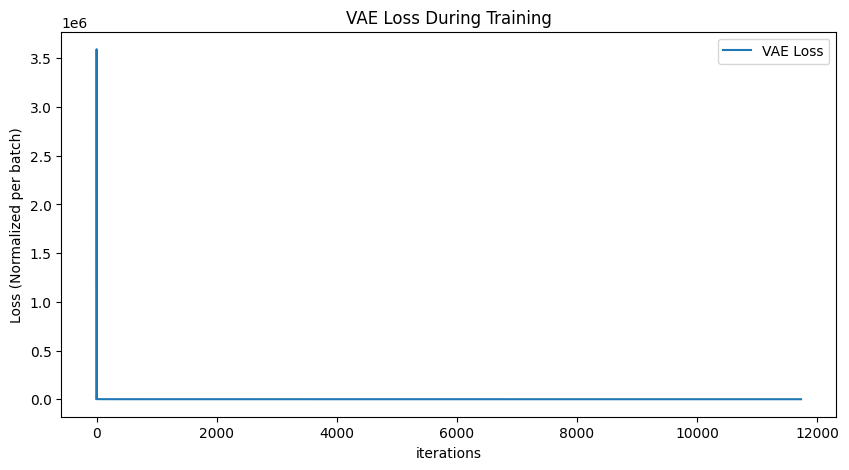

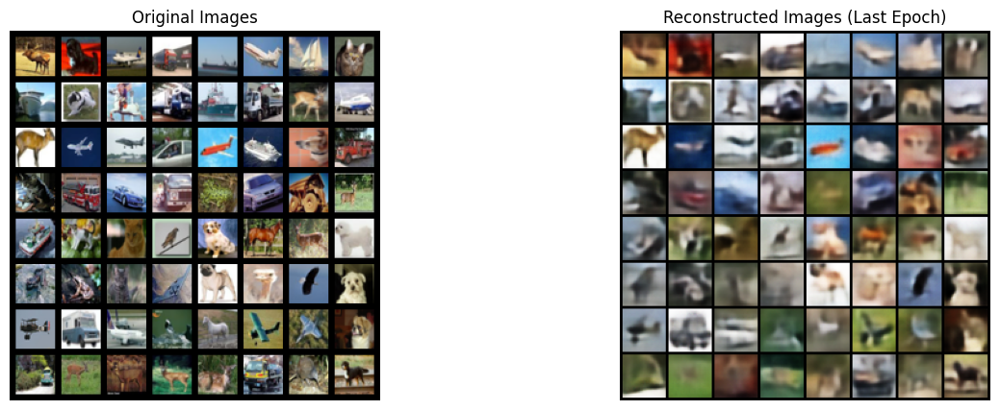

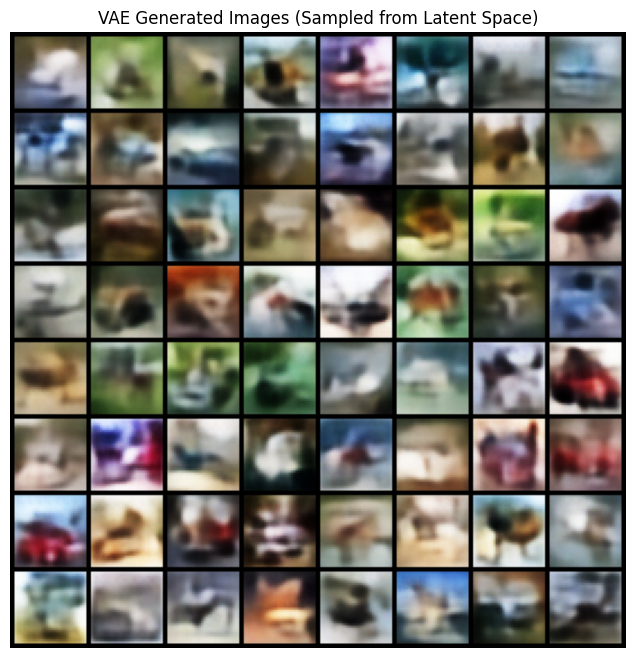

In [ ]:

vae_losses = []
vae_img_list = []
vae_iters = 0
vae_num_epochs = 30

print("\nStarting VAE Training Loop...")
for epoch in range(vae_num_epochs):
    for i, data in enumerate(dataloader, 0):
        netVAE.zero_grad()
        real_cpu = data[0].to(device)
        recon_batch, mu, logvar = netVAE(real_cpu)
        loss = vae_loss_function(recon_batch, real_cpu, mu, logvar)
        loss.backward()
        optimizerVAE.step()
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tVAE Loss: %.4f'
                  % (epoch, vae_num_epochs, i, len(dataloader),
                     loss.item() / real_cpu.size(0)))

        vae_losses.append(loss.item() / real_cpu.size(0))

        if vae_iters == 0:
             fixed_real_batch = real_cpu[:64].detach().cpu()

        if (vae_iters % 500 == 0) or ((epoch == vae_num_epochs - 1) and (i == len(dataloader) - 1)):
            with torch.no_grad():
                recon_fixed_batch, _, _ = netVAE(fixed_real_batch.to(device))
                vae_img_list.append(vutils.make_grid(recon_fixed_batch.detach().cpu(), padding=2, normalize=True))


        vae_iters += 1

plt.figure(figsize=(10,5))
plt.title("VAE Loss During Training")
plt.plot(vae_losses, label="VAE Loss")
plt.xlabel("iterations")
plt.ylabel("Loss (Normalized per batch)")
plt.legend()
plt.show()


plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.axis("off")
plt.title("Original Images")
plt.imshow(np.transpose(vutils.make_grid(fixed_real_batch, padding=5, normalize=True), (1, 2, 0)))

plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Reconstructed Images (Last Epoch)")
plt.imshow(np.transpose(vae_img_list[-1], (1, 2, 0)))
plt.show()


plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("VAE Generated Images (Sampled from Latent Space)")
with torch.no_grad():
    vae_sample_noise = torch.randn(64, netVAE.nz, 1, 1, device=device)
    vae_generated_images = netVAE.decoder(vae_sample_noise).detach().cpu()
    plt.imshow(np.transpose(vutils.make_grid(vae_generated_images, padding=2, normalize=True), (1,2,0)))
plt.show()


In [ ]:
import torch
import torch.nn.functional as F
from math import exp
from torchvision.models import inception_v3
import numpy as np

def inception_score(
    generator,
    nz_latent: int,
    n_samples: int = 5000,
    batch_size: int = 100,
    splits: int = 10,
    device: str = 'cuda'
):


    inception = inception_v3(pretrained=True, transform_input=False, aux_logits=True).to(device)
    inception.eval()
    for p in inception.parameters():
        p.requires_grad_(False)


    N = n_samples
    preds = torch.zeros(N, 1000, device='cpu')

    n_batches = n_samples // batch_size
    assert n_batches * batch_size == n_samples, "n_samples must be divisible by batch_size"

    idx = 0
    with torch.no_grad():
        for _ in range(n_batches):
            z = torch.randn(batch_size, nz_latent, device=device)
            z = z.view(batch_size, nz_latent, 1, 1)
            fake_imgs = generator(z)
            fake_imgs = F.interpolate(fake_imgs, size=(299, 299),
                                     mode='bilinear', align_corners=False)

            fake_imgs = (fake_imgs + 1.0) / 2.0
            mean = torch.tensor([0.485, 0.456, 0.406],
                                device=device).view(1, 3, 1, 1)
            std  = torch.tensor([0.229, 0.224, 0.225],
                                device=device).view(1, 3, 1, 1)
            fake_imgs = (fake_imgs - mean) / std
            logits = inception(fake_imgs)
            if isinstance(logits, tuple):
                logits = logits[0]

            softmax_out = F.softmax(logits, dim=1)
            preds[idx : idx + batch_size, :] = softmax_out.cpu()
            idx += batch_size


    preds_np = preds.numpy()
    scores = []
    split_size = N // splits

    for k in range(splits):
        start = k * split_size
        end   = (k + 1) * split_size
        part  = preds_np[start:end, :]
        py = np.mean(part, axis=0, keepdims=True)

        kl_divs = part * (np.log(part + 1e-16) - np.log(py + 1e-16))
        sum_kl = np.sum(kl_divs, axis=1)
        avg_kl = np.mean(sum_kl)
        is_k   = exp(avg_kl)
        scores.append(is_k)

    is_mean = float(np.mean(scores))
    is_std  = float(np.std(scores))
    return is_mean, is_std

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

nz_vae = netVAE.nz

is_mean, is_std = inception_score(
    generator   = netVAE.decoder,
    nz_latent   = nz_vae,
    n_samples   = 5000,
    batch_size  = 100,
    splits      = 10,
    device      = device
)

print(f"Inception Score: {is_mean:.4f} ± {is_std:.4f}")

Inception Score: 2.6568 ± 0.0702
